## Here we will load the analysis saved in Matlab using `AnalyzeFlow` and make some plots.

In [1]:
%load_ext autoreload
%autoreload 2

import os
import numpy as np
import pandas as pd
from IPython.display import display
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import tifffile

%matplotlib notebook
import matplotlib.pyplot as plt


## Load analysis for one kymograph

We are interested in 'algorithm', 'time', and 'velocity'

delx and delt are our space and time scale (same for all lines in a given kymograph)

In [2]:
# specify analysis file saved by Matlab AnalyzeFlow
path = '/Users/cudmore/Dropbox/data/declan/Bloodflow TIFs nov 23/20221102/20221102-matlab-analysis/Capillary3_combined.csv'

# use Python pandas to load it
dfMaster = pd.read_csv(path)

# display the loaded file as a table
display(dfMaster)

,filepath,parentFolder,file,acqDate,acqTime,analysisDate,analysisTime,pntsPerLine,numLines,delx,...,x1,x2,algorithm,k_numavgs,k_skipamt,k_shiftamt,c_hi,c_lineskip,time,velocity
0,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,chhatbar,NaN,NaN,NaN,100,16,0.060076,-1.876883
1,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,chhatbar,NaN,NaN,NaN,100,16,0.078924,-2.051154
2,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,chhatbar,NaN,NaN,NaN,100,16,0.097771,-2.051154
3,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,chhatbar,NaN,NaN,NaN,100,16,0.116619,-2.051154
4,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,chhatbar,NaN,NaN,NaN,100,16,0.135466,-2.051154
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9361,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,drew,NaN,NaN,NaN,100,16,35.311907,-2.374095
9362,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,drew,NaN,NaN,NaN,100,16,35.316619,-2.374095
9363,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,drew,NaN,NaN,NaN,100,16,35.321331,-2.374095
9364,/Users/cudmore/Dropbox/data/declan/Bloodflow T...,20221102,Capillary3.tif,NaN,NaN,20221201,11:56:15,42,30000,0.331,...,5,37,drew,NaN,NaN,NaN,100,16,35.326042,-2.374095


## Plot with plotly

In [3]:
color_discrete_map = {'drew': 'rgb(0,255,255)', 'chhatbar': 'rgb(255,0,0)'}
fig = px.scatter(dfMaster, x="time", y="velocity", color="algorithm",
                 color_discrete_map=color_discrete_map,
                 hover_data=['algorithm', 'velocity'])

# Re-order the data, this is not optimal
fig.data = (fig.data[1],fig.data[0])

fig.show()

## Load a directory of analysis and make a report

This does not remove outliers

In [4]:
from flowUtil import makeSummaryTable

folderPath = '/Users/cudmore/Dropbox/data/declan/Bloodflow TIFs nov 23/20221102'
#folderPath = '/Users/cudmore/Dropbox/data/declan/Bloodflow TIFs nov 23/20221114'
folderPath = '/Users/cudmore/Dropbox/data/declan/20221202'

timeLimitDict = {
    'Capillary4_0002.tif': {'minTime':0, 'maxTime':23}
}
#timeLimitDict = None
removeOutliers = True

dfSummary = makeSummaryTable(folderPath,
                             timeLimitDict=timeLimitDict,
                            removeOutliers=removeOutliers)

display(dfSummary)

## plot summary across files of drew and chhatbar velocity.
fig = px.scatter(dfSummary, x="meanVelDrew", y="meanVelChhatbar",
                 hover_data=['file'])

# want to plot std of each point but looks aweful
# fig = px.scatter(dfSummary, x="meanVelDrew", y="meanVelChhatbar",
#                  error_x='stdVelDrew', error_y='stdVelChhatbar',
#                  hover_data=['file'])



xMin = min( min(dfSummary['meanVelDrew']), min(dfSummary['meanVelChhatbar']))
xMax = max( max(dfSummary['meanVelDrew']), max(dfSummary['meanVelChhatbar']))

print('xMin:', xMin, 'xMax:', xMax)

_unityLine = go.Scatter(x=[xMin,xMax], y=[xMin,xMax],
                        mode='lines')
fig.add_trace(_unityLine)
              
fig.show()


,parentFolder,file,pntsPerLine,numLines,delx,delt,Total Dur (s),Line Length (um),meanVelDrew,stdVelDrew,nDrew,nDrewNan,meanVelChhatbar,stdVelChhatbar,nChhatbar,nChhatbarNan
0,20221202,Capillary 1.tif,33,30000,0.497,0.001162,34.86,16.401,0.977503,0.126918,7180,317,1.010479,0.068539,1723,146
1,20221202,Capillary 2.tif,31,30000,0.497,0.001158,34.74,15.407,1.802499,0.209856,7175,322,1.795413,0.093467,1805,64
2,20221202,Capillary10.tif,23,30000,0.497,0.001142,34.26,11.431,1.246886,0.135713,7187,310,1.218029,0.083837,1803,66
3,20221202,Capillary3.tif,36,30000,0.497,0.001166,34.98,17.892,1.226583,0.170523,7460,37,1.218425,0.090874,1783,86
4,20221202,Capillary4.tif,39,30000,0.497,0.001174,35.22,19.383,1.020130,0.121328,7204,293,1.036463,0.047535,1780,89
5,20221202,Capillary5.tif,29,30000,0.497,0.001154,34.62,14.413,1.131242,0.147419,7484,13,1.067000,0.070246,1795,74
6,20221202,Capillary6.tif,21,30000,0.497,0.001138,34.14,10.437,2.079263,0.283342,7357,140,2.002626,0.151571,1784,85
7,20221202,Capillary7.tif,31,30000,0.497,0.001158,34.74,15.407,1.041740,0.125822,7175,322,1.045048,0.068161,1751,118
8,20221202,Capillary8.tif,26,30000,0.497,0.001146,34.38,12.922,1.591979,0.893454,7416,81,2.043681,0.149795,1739,130
9,20221202,Capillary9.tif,30,30000,0.497,0.001154,34.62,14.910,1.008160,0.119025,7216,281,0.974624,0.064253,1808,61


xMin: 0.9746240315265488 xMax: 2.079262862443931


In [5]:
# bar plots! Everybody loves bar plots!
fig = go.Figure()
fig.add_trace(go.Bar(
    name='Drew',
    x=dfSummary['file'], y=dfSummary['meanVelDrew'],
    error_y=dict(type='data', array=dfSummary['stdVelDrew'])
))

fig.add_trace(go.Bar(
    name='Chhatbar',
    x=dfSummary['file'], y=dfSummary['meanVelChhatbar'],
    error_y=dict(type='data', array=dfSummary['stdVelChhatbar'])
))
fig.update_layout(barmode='group')

fig.show()

## Plot results of one capillary

- kymograph
- vel drew
- vel chhatbar


In [7]:
from flowUtil import plotFlowAnalysis, plotFlowAnalysis_Update
import ipywidgets as widgets
from IPython.display import display, clear_output
import plotly.graph_objects as go

folderPath = '/Users/cudmore/Dropbox/data/declan/Bloodflow TIFs nov 23/20221102'
folderPath = '/Users/cudmore/Dropbox/data/declan/Bloodflow TIFs nov 23/20221114'
folderPath = '/Users/cudmore/Dropbox/data/declan/20221202'

# get list of tif from folder
files = os.listdir(folderPath)
files = sorted(files)
fileList = []
for file in files:
    if not file.endswith('.tif'):
        continue
    #filePath = os.path.join(folderPath, file)
    fileList.append(file)
    
myDropdown = widgets.Dropdown(
    options=fileList,
    #value='2',
    description='File:',
    disabled=False,
)


def dropdown_eventhandler(change):
    """
    change: traitlets.utils.bunch.Bunch
    """
    
    clear_output(wait=True)

    # load
    tifName = change.new
    tifPath = os.path.join(folderPath, tifName)  # USING GLOBAL
        
    # show file dropdown
    display(myDropdown)

    # show figure
    fig = plotFlowAnalysis(tifPath)
    figWidget = go.FigureWidget(fig);
    figWidget.show()

myDropdown.observe(dropdown_eventhandler, names='value')

display(myDropdown)

tifName = fileList[0]
tifPath = os.path.join(folderPath, tifName)  # USING GLOBAL

fig = plotFlowAnalysis(tifPath)
#fig.show()

figWidget = go.FigureWidget(fig);
figWidget.show()


Dropdown(description='File:', options=('Capillary 1.tif', 'Capillary 2.tif', 'Capillary10.tif', 'Capillary3.ti…

## Refine analysis by limiting the line scans to include

See Capillary4_0002.tif

In [20]:
def plotVelocity(dfPlot, removeOutliers=True):
    """Plot velocity from df.
    """

    timeDrew = dfPlot[ dfPlot['algorithm'] == 'drew']['time'].to_numpy()
    velDrew = dfPlot[ dfPlot['algorithm'] == 'drew']['velocity'].to_numpy()
    if removeOutliers:
        velDrew = _removeOutliers(velDrew)

    timeChhatbar = dfPlot[ dfPlot['algorithm'] == 'chhatbar']['time'].to_numpy()
    velChhatbar = dfPlot[ dfPlot['algorithm'] == 'chhatbar']['velocity'].to_numpy()
    if removeOutliers:
        velChhatbar = _removeOutliers(velChhatbar)

    # plot with matplotlib

    fig, axs = plt.subplots(2,1, sharex=True)

    axs[0].plot(timeDrew, velDrew)
    
    axs[1].plot(timeChhatbar, velChhatbar)


## Make 2 versions of velocity plots to show analysis workflow

1) The raw velocity
2) Reduce time for errors in the linescans
3) remove velocity outliers (algorithms hiccups)

<IPython.core.display.Javascript object>


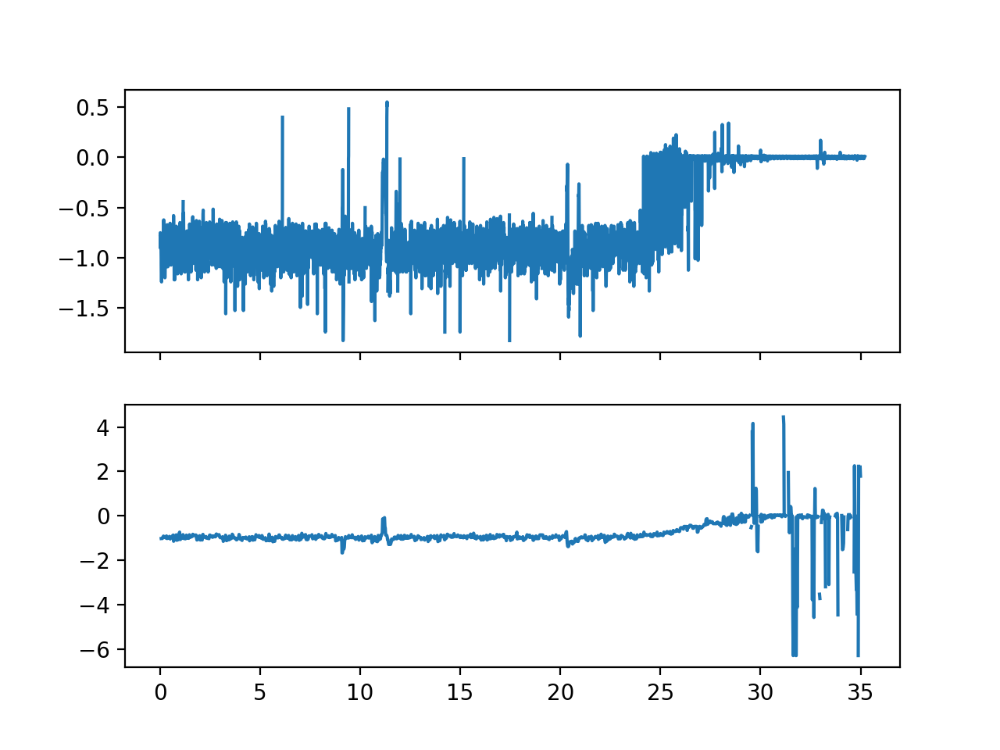

<IPython.core.display.Javascript object>


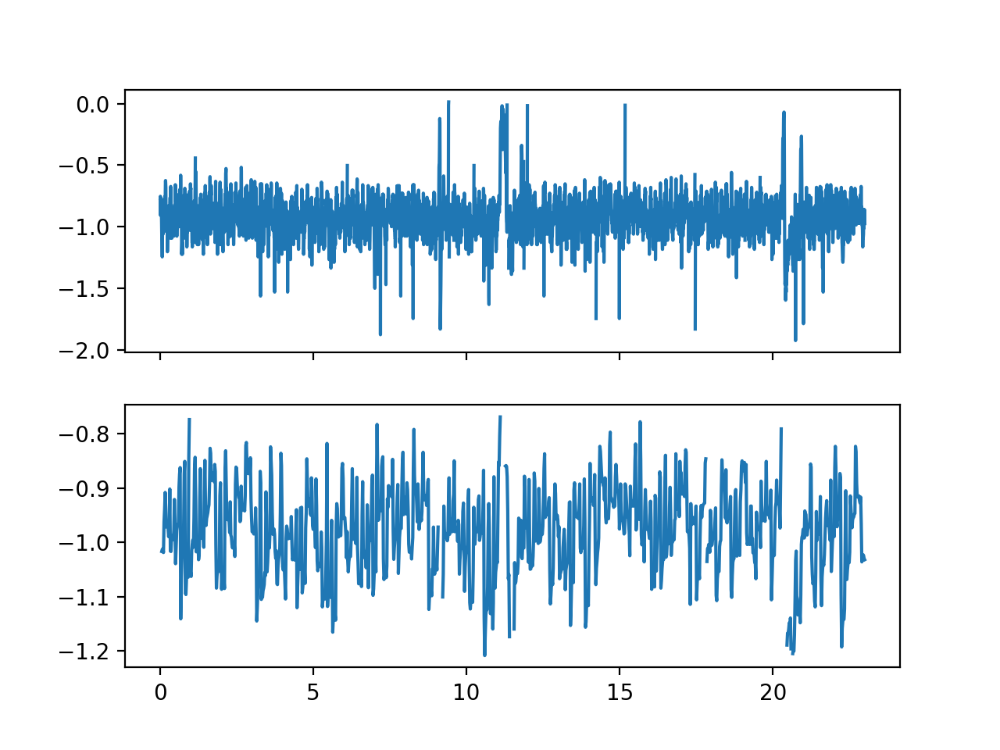

<IPython.core.display.Javascript object>


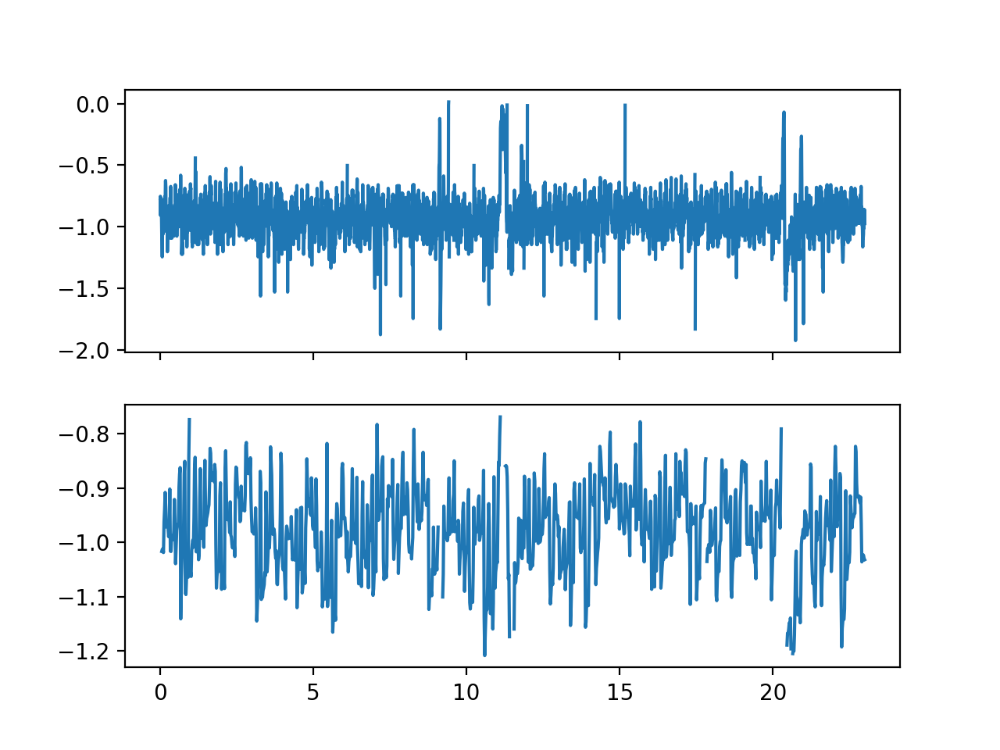

In [22]:
from flowUtil import _getCsvFile
from flowUtil import _removeOutliers

tifPath = '/Users/cudmore/Dropbox/data/declan/Bloodflow TIFs nov 23/20221102/Capillary4_0002.tif'
csvPath = _getCsvFile(tifPath)
dfMaster = pd.read_csv(csvPath)

plotVelocity(dfMaster, removeOutliers=True)

#limit line scans by time
dfLimit = dfMaster[ dfMaster['time'] < 23]  # seconds
plotVelocity(dfLimit, removeOutliers=True)

#plotVelocity(dfLimit, removeOutliers=True)

plt.show()

# tifPath = os.path.join(folderPath, 'Capillary4_0002.tif')
# fig = plotFlowAnalysis(tifPath)
# fig.show()
